# Correlation in Python - Movies Dataset
The objective of this project is to find the best correlations in a movies dataset. It'll have the next sections:

<ul>
    <li>EDA & Data cleaning with pandas methods.</li>
    <li>Data visualizations using matplotlib and seaborn.</li>
    <li>Correlation matrix using seaborn.</li>
</ul>

In [72]:
# Import libraries
import pandas as pd
pd.set_option('display.max_columns', None)
import matplotlib 
import matplotlib.pyplot as plt 
from matplotlib.pyplot import figure
import seaborn as sns
import re

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

sns.set()

In [73]:
# Read the data using pandas
raw_data = pd.read_csv('movies.csv')
raw_data.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [74]:
# Count rows and columns
raw_data.shape

(7668, 15)

In [75]:
# Let's see if there is missing data
raw_data.isnull().sum()

name           0
rating        77
genre          0
year           0
released       2
score          3
votes          3
director       0
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64

In [76]:
# Look at the percentages
(raw_data.isnull().sum()/len(raw_data)*100).round(2)

name         0.00
rating       1.00
genre        0.00
year         0.00
released     0.03
score        0.04
votes        0.04
director     0.00
writer       0.04
star         0.01
country      0.04
budget      28.31
gross        2.46
company      0.22
runtime      0.05
dtype: float64

<AxesSubplot:>

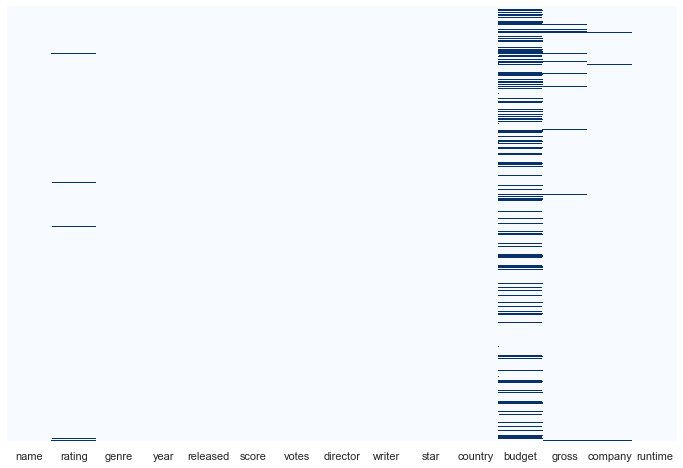

In [77]:
# Better visualize the null values.
sns.heatmap(raw_data.isnull(), yticklabels=False, cbar=False, cmap='Blues')

In [78]:
# Drop null values in columns where the percentage is low
raw_data.dropna(subset=[x for x in raw_data.columns if x != 'budget'], inplace=True)

In [79]:
# It only remains the column budget with null values.
# Because it was almost 29% of the total null values, I'll do a different approach.
raw_data.isnull().sum()

name           0
rating         0
genre          0
year           0
released       0
score          0
votes          0
director       0
writer         0
star           0
country        0
budget      1991
gross          0
company        0
runtime        0
dtype: int64

C:\Users\moren\.conda\envs\py3-TF2.0\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


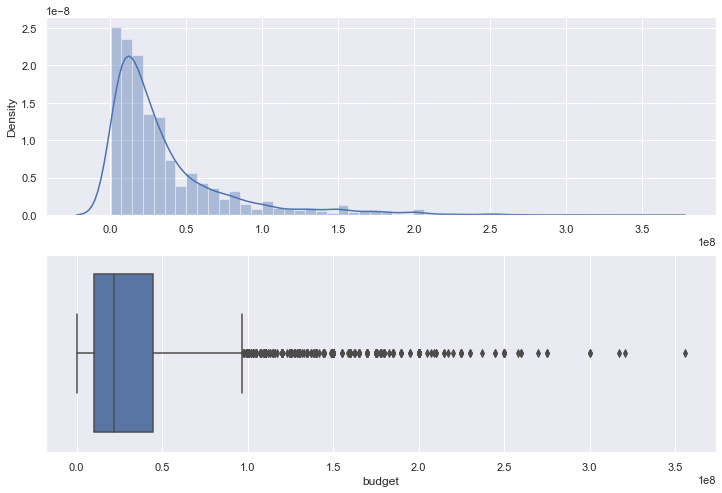

In [80]:
# First make sure how this budget column is distributed.
plt.subplot(2,1,1)
sns.distplot(x=raw_data['budget'])

plt.subplot(2,1,2)
sns.boxplot(x=raw_data['budget'])

plt.show()

In [81]:
# The distribution is right-skewed.
raw_data['budget'].describe()

count    5.421000e+03
mean     3.600917e+07
std      4.157337e+07
min      6.000000e+03
25%      1.000000e+07
50%      2.180000e+07
75%      4.500000e+07
max      3.560000e+08
Name: budget, dtype: float64

In [82]:
# Before I fill the missing values I want to keep track of them, to take them into account in the future analysis.
raw_data['budget_missing'] = raw_data['budget'].apply(lambda x: 1 if pd.isna(x) else 0)

In [83]:
# Because of how the data is distributed I'll fill the missing values with median of the column.
raw_data['budget'].fillna(raw_data['budget'].median(), inplace=True)

In [84]:
#Not null values remain.
raw_data.isnull().sum().sum()

0

In [85]:
# Now let's take a look at the data types for our columns
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7412 entries, 0 to 7659
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            7412 non-null   object 
 1   rating          7412 non-null   object 
 2   genre           7412 non-null   object 
 3   year            7412 non-null   int64  
 4   released        7412 non-null   object 
 5   score           7412 non-null   float64
 6   votes           7412 non-null   float64
 7   director        7412 non-null   object 
 8   writer          7412 non-null   object 
 9   star            7412 non-null   object 
 10  country         7412 non-null   object 
 11  budget          7412 non-null   float64
 12  gross           7412 non-null   float64
 13  company         7412 non-null   object 
 14  runtime         7412 non-null   float64
 15  budget_missing  7412 non-null   int64  
dtypes: float64(5), int64(2), object(9)
memory usage: 984.4+ KB


In [86]:
# Change data type to get rid of that ".0" at the end
raw_data['budget'] = raw_data['budget'].astype('int64')
raw_data['gross'] = raw_data['gross'].astype('int64')
raw_data['votes'] = raw_data['votes'].astype('int64')
raw_data['runtime'] = raw_data['runtime'].astype('int64')

In [87]:
raw_data.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,budget_missing
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146,0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104,0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124,0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88,0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98,0


In [88]:
# Extract the correct year (according to data source) from the column released using regex.
raw_data['year'] = raw_data['released'].apply(lambda x: re.search('(\d{4})', x)[0])

In [89]:
raw_data.sort_values(by=['gross'], ascending=False, inplace=True)
raw_data.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,budget_missing
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,0
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,0
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,0
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,0
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,0


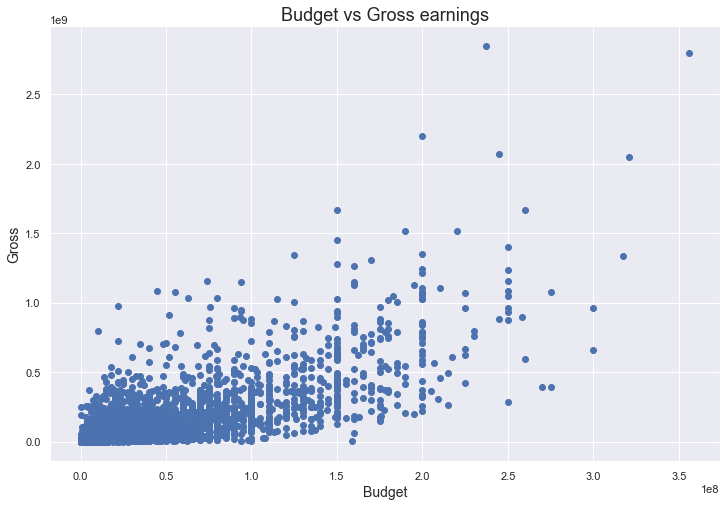

In [90]:
# Scatter plot with budget and gross
plt.scatter(raw_data['budget'], raw_data['gross'])
plt.xlabel('Budget', size=14)
plt.ylabel('Gross', size=14)
plt.title('Budget vs Gross earnings', size=18)

plt.show()

Text(0.5, 1.0, 'Budget vs Gross using seaborn')

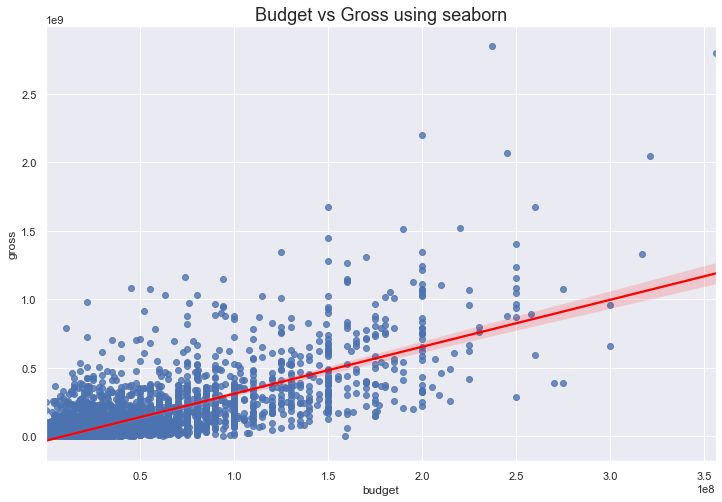

In [91]:
# Plot budget vs gross using seaborn
ax = sns.regplot(x='budget', y='gross', data=raw_data, line_kws={'color':'red'})
ax.set_title('Budget vs Gross using seaborn', size=18)

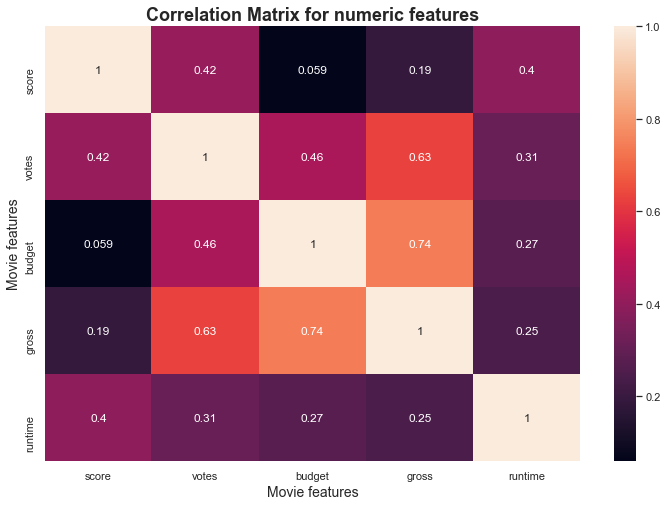

In [92]:
# Let's start looking at the correlations
correlations = raw_data.drop('budget_missing', axis=1).corr()
sns.heatmap(correlations, annot=True)

plt.xlabel('Movie features', size=14)
plt.ylabel('Movie features', size=14)
plt.title('Correlation Matrix for numeric features', size=18, fontweight='bold')

plt.show()

In [93]:
# High correaltion between budget and gross

In [94]:
df_numarized = raw_data.copy()

for col_name in df_numarized.columns:
    if df_numarized[col_name].dtype == 'object':
        df_numarized[col_name] = df_numarized[col_name].astype('category')
        df_numarized[col_name] = df_numarized[col_name].cat.codes

# Check if everything worked properly
df_numarized.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,budget_missing
5445,515,5,0,29,678,7.8,1100000,1107,1705,2198,53,237000000,2847246203,2115,162,0
7445,517,5,0,39,176,8.4,903000,160,708,2107,53,356000000,2797501328,1508,181,0
3045,6668,5,6,17,686,7.8,1100000,1107,1705,1502,53,200000000,2201647264,2115,194,0
6663,4958,5,0,35,680,7.8,876000,1077,2448,494,53,245000000,2069521700,1446,138,0
7244,518,5,0,38,185,8.4,897000,160,708,2107,53,321000000,2048359754,1508,149,0


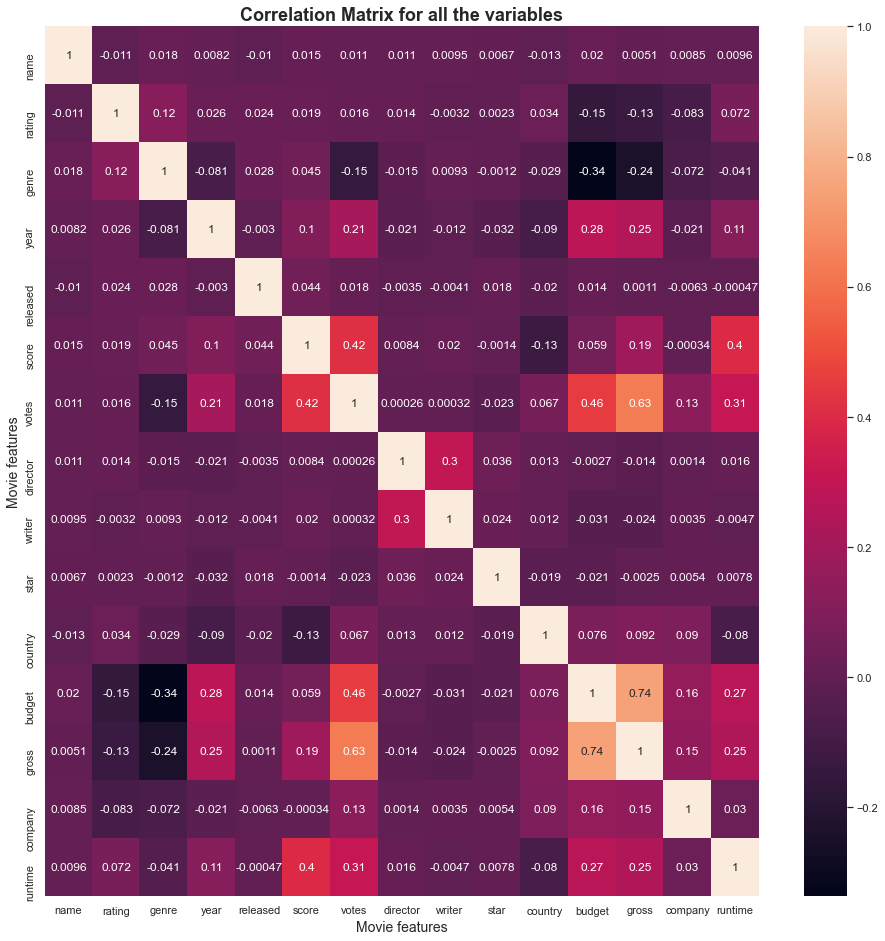

In [95]:
correlations = df_numarized.drop('budget_missing', axis=1).corr()
fig,ax = plt.subplots(figsize=(16,16))
sns.heatmap(correlations, annot=True)

ax.set_xlabel('Movie features', size=14)
ax.set_ylabel('Movie features', size=14)
ax.set_title('Correlation Matrix for all the variables', size=18, fontweight='bold')

plt.show()

In [96]:
full_correlations = df_numarized.corr()

corr_pairs = full_correlations.unstack()
corr_pairs

name            name              1.000000
                rating           -0.010815
                genre             0.018363
                year              0.008209
                released         -0.010012
                                    ...   
budget_missing  budget           -0.174442
                gross            -0.240615
                company          -0.120115
                runtime          -0.062942
                budget_missing    1.000000
Length: 256, dtype: float64

In [97]:
sorted_pairs = corr_pairs.sort_values()
sorted_pairs

genre           budget           -0.336743
budget          genre            -0.336743
genre           gross            -0.242597
gross           genre            -0.242597
votes           budget_missing   -0.242544
                                    ...   
year            year              1.000000
genre           genre             1.000000
rating          rating            1.000000
runtime         runtime           1.000000
budget_missing  budget_missing    1.000000
Length: 256, dtype: float64

In [98]:
high_corr = sorted_pairs[sorted_pairs > 0.5]
high_corr

gross           votes             0.631110
votes           gross             0.631110
gross           budget            0.744394
budget          gross             0.744394
name            name              1.000000
company         company           1.000000
gross           gross             1.000000
budget          budget            1.000000
country         country           1.000000
star            star              1.000000
writer          writer            1.000000
director        director          1.000000
votes           votes             1.000000
score           score             1.000000
released        released          1.000000
year            year              1.000000
genre           genre             1.000000
rating          rating            1.000000
runtime         runtime           1.000000
budget_missing  budget_missing    1.000000
dtype: float64

<h2>Votes and budget have the highest correlation to gross earnings.</h2>